In [1]:
%pip install mediapipe

Note: you may need to restart the kernel to use updated packages.


In [2]:
import mediapipe as mp
import cv2 
import itertools 
import numpy as np 
import matplotlib.pyplot as plt 
from time import time

In [3]:
mp_face_detection = mp.solutions.face_detection 

face_detection = mp_face_detection.FaceDetection(model_selection=0, min_detection_confidence=0.5)

mp_drawing = mp.solutions.drawing_utils

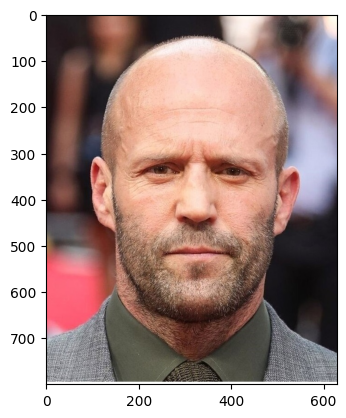

In [4]:
test_img = cv2.imread('test.jpg')
test_img = cv2.cvtColor(test_img, cv2.COLOR_RGB2BGR)
plt.imshow(test_img)
plt.show()

In [5]:
face_detection_results = face_detection.process(test_img[:,:,::-1])
print(face_detection_results.detections)

[label_id: 0
score: 0.89763373
location_data {
  format: RELATIVE_BOUNDING_BOX
  relative_bounding_box {
    xmin: 0.2153651
    ymin: 0.3070611
    width: 0.59006387
    height: 0.46386024
  }
  relative_keypoints {
    x: 0.38805646
    y: 0.4176537
  }
  relative_keypoints {
    x: 0.6592502
    y: 0.42769146
  }
  relative_keypoints {
    x: 0.52579385
    y: 0.5220427
  }
  relative_keypoints {
    x: 0.5154721
    y: 0.62888765
  }
  relative_keypoints {
    x: 0.22890519
    y: 0.46511054
  }
  relative_keypoints {
    x: 0.7863699
    y: 0.48606977
  }
}
]


FACE NUMBER: 1
-------------------------------------------
Face confidence: 0.9
Face bounding box:
xmin: 0.2153651
ymin: 0.3070611
width: 0.59006387
height: 0.46386024

RIGHT_EYE
x: 0.38805646
y: 0.4176537

LEFT_EYE
x: 0.6592502
y: 0.42769146

NOSE_TIP
x: 0.52579385
y: 0.5220427

MOUTH_CENTER
x: 0.5154721
y: 0.62888765

RIGHT_EAR_TRAGION
x: 0.22890519
y: 0.46511054

LEFT_EAR_TRAGION
x: 0.7863699
y: 0.48606977



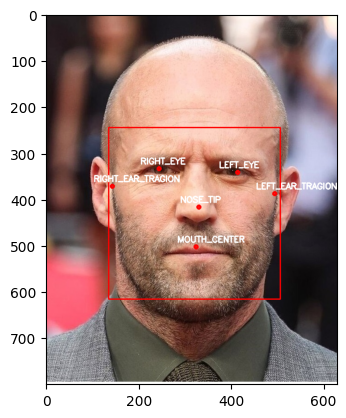

In [6]:
plt.imshow(test_img)
if face_detection_results.detections:
    for face_no, face in enumerate(face_detection_results.detections):

        print(f'FACE NUMBER: {face_no + 1}')
        print('-------------------------------------------')

        print(f'Face confidence: {round(face.score[0], 2)}')

        face_data = face.location_data
        print(f'Face bounding box:\n{face_data.relative_bounding_box}')
        box = face_data.relative_bounding_box
        cv2.rectangle(test_img, (int(test_img.shape[1] * box.xmin), int(test_img.shape[0] * box.ymin)), (int(test_img.shape[1] * (box.xmin + box.width)), int(test_img.shape[0] * (box.ymin + box.height))), color=(255, 0, 0), thickness=2)
        for i in range(6):
            print(f'{mp_face_detection.FaceKeyPoint(i).name}')
            print(f'{face_data.relative_keypoints[mp_face_detection.FaceKeyPoint(i).value]}')
            xy = face_data.relative_keypoints[mp_face_detection.FaceKeyPoint(i).value]
            x = int(test_img.shape[1] * xy.x)
            y = int(test_img.shape[0] * xy.y)
            cv2.putText(test_img, mp_face_detection.FaceKeyPoint(i).name, (x - 40, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2)
            cv2.circle(test_img, (x,y), radius=3, color=(255, 0, 0), thickness=3)
plt.imshow(test_img)
plt.show()

In [7]:
mp_face_mesh = mp.solutions.face_mesh

face_mesh_images = mp_face_mesh.FaceMesh(static_image_mode=True, max_num_faces=2, min_detection_confidence=0.5)

face_mesh_videos = mp_face_mesh.FaceMesh(static_image_mode=False, max_num_faces=3,
                                         min_detection_confidence=0.5, min_tracking_confidence=0.3)

mp_drawing_styles = mp.solutions.drawing_styles

Face number: 1
-----------------------------------------
LEFT EYE landmarks:

x: 0.6109555
y: 0.42485076
z: 0.01220419

x: 0.63181573
y: 0.4228564
z: 0.0070293276

x: 0.65265167
y: 0.42358282
z: 0.008816168

x: 0.67306346
y: 0.42734253
z: 0.015202495

x: 0.6858022
y: 0.43173447
z: 0.023874797

x: 0.6791026
y: 0.44155616
z: 0.029617086

x: 0.69874674
y: 0.43692014
z: 0.0432021

x: 0.58970535
y: 0.4341674
z: 0.020535592

x: 0.5965066
y: 0.42980132
z: 0.016782945

x: 0.69314396
y: 0.43488708
z: 0.032102387

x: 0.6645989
y: 0.44309193
z: 0.022041785

x: 0.64337146
y: 0.44322196
z: 0.015426375

x: 0.68952686
y: 0.43987185
z: 0.036248267

x: 0.62337214
y: 0.44102785
z: 0.013190467

x: 0.6051218
y: 0.43717968
z: 0.015648682

x: 0.594354
y: 0.43532586
z: 0.019982731

x: 0.36846894
y: 0.42054388
z: 0.0025272463

x: 0.34118593
y: 0.42927194
z: 0.028349683

x: 0.35521847
y: 0.4245859
z: 0.0103599485

x: 0.3616405
y: 0.43518937
z: 0.01609237

x: 0.45163664
y: 0.4311316
z: 0.0139063

x: 0.35080463


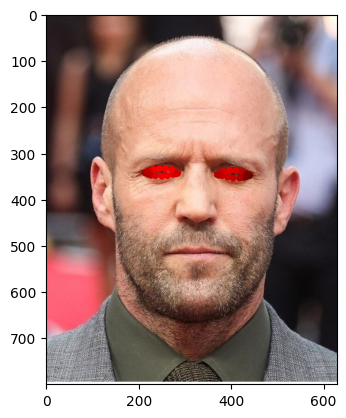

In [8]:
test_img = cv2.imread('test.jpg')
test_img = cv2.cvtColor(test_img, cv2.COLOR_RGB2BGR)

face_mesh_results = face_mesh_images.process(test_img[:,:,::-1])

LEFT_EYE_INDEXES = list(set(itertools.chain(*mp_face_mesh.FACEMESH_LEFT_EYE)))
RIGHT_EYE_INDEXES = list(set(itertools.chain(*mp_face_mesh.FACEMESH_RIGHT_EYE)))
LEFT_IRIS_INDEXES = list(set(itertools.chain(*mp_face_mesh.FACEMESH_LEFT_IRIS)))

if face_mesh_results.multi_face_landmarks:
    for face_no,face_landmarks in enumerate(face_mesh_results.multi_face_landmarks):
        print(f'Face number: {face_no + 1}\n-----------------------------------------')
        print(f'LEFT EYE landmarks:\n')

        for index in LEFT_EYE_INDEXES:
            xy = face_landmarks.landmark[index]
            x = int(test_img.shape[1] * xy.x)
            y = int(test_img.shape[0] * xy.y)
            #cv2.putText(test_img, mp_face_detection.FaceKeyPoint(i).name, (x - 40, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2)
            cv2.circle(test_img, (x,y), radius=4, color=(int(255 * (1 - 15 * xy.z)), 0, 0), thickness=6)
            print(face_landmarks.landmark[index])

        for index in RIGHT_EYE_INDEXES:
            xy = face_landmarks.landmark[index]
            x = int(test_img.shape[1] * xy.x)
            y = int(test_img.shape[0] * xy.y)
            #cv2.putText(test_img, mp_face_detection.FaceKeyPoint(i).name, (x - 40, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2)
            cv2.circle(test_img, (x,y), radius=4, color=(int(255 * (1 - 15 * xy.z)), 0, 0), thickness=6)
            print(face_landmarks.landmark[index])
    
plt.imshow(test_img)
plt.show()
        

In [17]:
def draw_landmarks(test_img, face_mesh_images, display):
    img_copy = test_img.copy()
    
    mp_drawing_styles = mp.solutions.drawing_styles
    parts_style = mp_drawing_styles.DrawingSpec(color = (255, 255, 255), thickness = 3, circle_radius = 3)
    contour_style = mp_drawing_styles.DrawingSpec(color = (0, 0, 255), thickness = 1, circle_radius = 3)
    face_mesh_results = face_mesh_images.process(test_img[:,:,::-1])    
    if face_mesh_results.multi_face_landmarks:
        for face_landmarks in face_mesh_results.multi_face_landmarks:
            if not display:
                print(f'Face landmarks:\n{face_landmarks.landmark}')
            mp_drawing.draw_landmarks(image=img_copy, landmark_list=face_landmarks, connections=mp_face_mesh.FACEMESH_TESSELATION,
                                    landmark_drawing_spec=None,
                                    connection_drawing_spec=contour_style)
            mp_drawing.draw_landmarks(image=img_copy, landmark_list=face_landmarks, connections=mp_face_mesh.FACEMESH_CONTOURS,
                                    landmark_drawing_spec=None,
                                    connection_drawing_spec=parts_style)
    if display:
        fig, axs = plt.subplots(1, 2, figsize=[10, 10])
        axs[0].set_title('Original image');axs[1].set_title('Output');axs[0].axis('off');axs[1].axis('off');axs[0].imshow(test_img);axs[1].imshow(img_copy);plt.show()
    return img_copy

In [10]:
test_img = cv2.imread('test3.jpg')
test_img = cv2.cvtColor(test_img, cv2.COLOR_RGB2BGR)

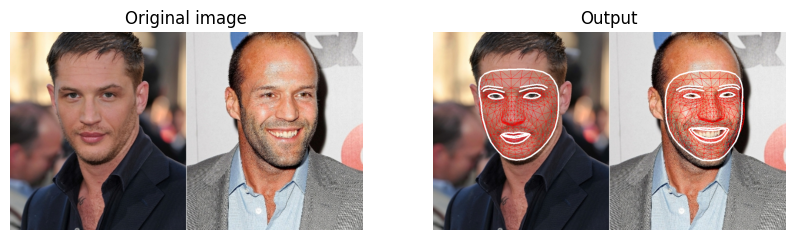

In [11]:
_ = draw_landmarks(test_img, face_mesh_images, True)

In [18]:
camera_video = cv2.VideoCapture(0)
camera_video.set(3, 1280)
camera_video.set(4, 960)

cv2.namedWindow('Face Landmarks Detection', cv2.WINDOW_NORMAL)

time1 = 0

while camera_video.isOpened():
    ok, frame = camera_video.read()

    if not ok:
        continue
    frame = cv2.flip(frame, 1)

    frame = draw_landmarks(frame, face_mesh_videos, display=False)

    time2 = time()

    if time2 - time1 > 0:
        frames_per_second = 1 / (time2 - time1)

        frame = cv2.putText(frame, f'FPS: {int(frames_per_second)}', (10, 30), cv2.FONT_HERSHEY_PLAIN, 2, (0, 255, 0), 3)
    
    time1 = time2

    cv2.imshow('Face Landmarks Detection', frame)

    k = cv2.waitKey(1) & 0xFF

    if k == 27:
        break

camera_video.release()

cv2.destroyAllWindows()


Face landmarks:
[x: 0.3466467
y: 0.77638644
z: -0.029871881
, x: 0.34682366
y: 0.69937366
z: -0.06434041
, x: 0.34669685
y: 0.72074676
z: -0.032225575
, x: 0.33816105
y: 0.62569094
z: -0.05159643
, x: 0.34719473
y: 0.67761934
z: -0.0693304
, x: 0.34788185
y: 0.6481603
z: -0.06579719
, x: 0.35035297
y: 0.57505804
z: -0.036914136
, x: 0.26654088
y: 0.56483424
z: 0.008764817
, x: 0.35218093
y: 0.52713394
z: -0.031473823
, x: 0.35296643
y: 0.49919713
z: -0.03534957
, x: 0.35550344
y: 0.38731942
z: -0.026244463
, x: 0.34670132
y: 0.7875334
z: -0.027436359
, x: 0.34678924
y: 0.7955334
z: -0.022823706
, x: 0.34680125
y: 0.79827297
z: -0.017177684
, x: 0.34689236
y: 0.8055859
z: -0.014430053
, x: 0.3467588
y: 0.8148855
z: -0.016199308
, x: 0.34647235
y: 0.8263823
z: -0.01866715
, x: 0.346403
y: 0.8388729
z: -0.016698211
, x: 0.34638444
y: 0.8565235
z: -0.0051510977
, x: 0.34653926
y: 0.70954454
z: -0.05764312
, x: 0.33440223
y: 0.7064956
z: -0.04100855
, x: 0.23045532
y: 0.47599822
z: 0.059011